# Setup

Run the cells below to load in Tensorflow and configure a GPU.

In [1]:
import os # Allows us to interact with the operating system
import tensorflow as tf

# Sets environment variable telling TensorFlow Hub to load modules in 'COMPRESSED' format
# This reduces the time and bandwith required for module loading
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

print("TF Version: ", tf.__version__)
print("GPU available: ", tf.config.list_physical_devices('GPU'))

TF Version:  2.14.0
GPU available:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


The code cell below contains imports for other relevant dependencies which will be used see our stylized image and the images that you will be collecting in the next section.

In [2]:
import IPython.display as display  # For seeing the state of your stylized image
import numpy as np    # For parsing arrays of training data and extracting information about stylized image

import matplotlib.pyplot as plt  # For displaying collected images in a plot
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12, 12)  # Set size for plots to be 12x12 inches
mpl.rcParams['axes.grid'] = False  # Do not display gridlines in plot

import PIL.Image  # For converting tensors to image
import time  # For seeing how long it takes to train our model

# Getting our inputs


The following three cells help us load the image, display the image, and convert the image tensor to a PIL image.

In [3]:
def load_image(url):
  """
      Given a url to the upload.wikimedia.org, we load the image and convert it
      into a tensor with a maximum dimension of 512px
  """

  max_pix = 512

  # Download image to a cache directory
  img = tf.keras.utils.get_file(os.path.basename(str(url))[-128:], str(url))
  img = tf.io.read_file(img)

  # Give image 3 color channels (RGB)
  img = tf.image.decode_image(img, channels=3)

  # Convert image to dtype float 32
  img = tf.image.convert_image_dtype(img, tf.float32)

  # Calculates shape and takes longest dimension
  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_pix / long_dim

  # Scales image to 512px to calculate longest dimension
  new_shape = tf.cast(shape * scale, tf.int32)
  print(new_shape)

  # Resizes image and adds a new axis to the tensor
  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]

  # Returns a tensor
  return img

In [4]:
def display_img(img, title=None):
  """
      Displays the image using matplotlib and checks if the image has more than 3 dimensions and if so,
      'squeeze' so that it only has height, width, channels
  """

  if len(img.shape) > 3:
    # Returns a tensor, a 3D matrix of shape (height, width, channels)
    img = tf.squeeze(img, axis=0)

  # Display image using matplotlib
  plt.imshow(img)

  # Set the title of the plot if one was given
  if title:
    plt.title(title)

In [5]:
def tensor_to_image(tensor):
  """ Converts tensor into an PIL.Image"""
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

These are the wikimedia links to the content and style images

In [6]:
content_image_urls = [
    'https://upload.wikimedia.org/wikipedia/commons/thumb/f/f2/Bistr_ruslan.jpg/1280px-Bistr_ruslan.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/1/13/Marcodelmart_-_A_portrait_of_Marco_Delgado.jpg',  # Portrait Content
    'https://upload.wikimedia.org/wikipedia/commons/3/30/Scarves.jpg',  # Figurative Content
    'https://upload.wikimedia.org/wikipedia/commons/8/8e/Landscape_with_rainbow_and_the_Old_Bridge_over_the_Nam_Khan_river_in_Luang_Prabang_Laos.jpg',  # Landscape Content
    'https://upload.wikimedia.org/wikipedia/commons/8/8b/The_Great_Wave_at_Kanagawa.jpg'  # Wave content
]

style_image_urls = [
    'https://upload.wikimedia.org/wikipedia/commons/thumb/5/53/02018_0136_I_love_Rozpucie.jpg/800px-02018_0136_I_love_Rozpucie.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/thumb/c/ca/Anonym_Kaiser_Ferdinand_I.jpg/1280px-Anonym_Kaiser_Ferdinand_I.jpg?20120219113923',  # Portrait style
    'https://upload.wikimedia.org/wikipedia/commons/1/1f/1990_-_%27Abstract_dunes%27_-_a_painted_landscape_in_oval_forms._The_abstract_painting_is_painted_by_Dutch_artist_Fons_Heijnsbroek_after_his_sketches_circa_1989-90%3B_free_high_resolution_art_image.jpg', # Abstract style
    'https://upload.wikimedia.org/wikipedia/commons/0/04/Alfred_Sisley_001.jpg',  # Landscape style
    'https://upload.wikimedia.org/wikipedia/commons/6/63/Fractured_Fibula.jpg' # X-ray style
]

Here we load all the style and content images and display them.

300506/300506 [==============================] - 0s 1us/step
tf.Tensor([360 512], shape=(2,), dtype=int32)
212385/212385 [==============================] - 0s 1us/step
tf.Tensor([512 370], shape=(2,), dtype=int32)
3919053/3919053 [==============================] - 0s 0us/step
tf.Tensor([512 512], shape=(2,), dtype=int32)
948313/948313 [==============================] - 0s 0us/step
tf.Tensor([512 359], shape=(2,), dtype=int32)
415928/415928 [==============================] - 0s 1us/step
tf.Tensor([410 512], shape=(2,), dtype=int32)
15179355/15179355 [==============================] - 1s 0us/step
tf.Tensor([397 512], shape=(2,), dtype=int32)
10608001/10608001 [==============================] - 0s 0us/step
tf.Tensor([319 511], shape=(2,), dtype=int32)
500207/500207 [==============================] - 0s 0us/step
tf.Tensor([381 512], shape=(2,), dtype=int32)
121673/121673 [==============================] - 0s 0us/step
tf.Tensor([353 512], shape=(2,), dtype=int32)
5625762/5625762 [==========

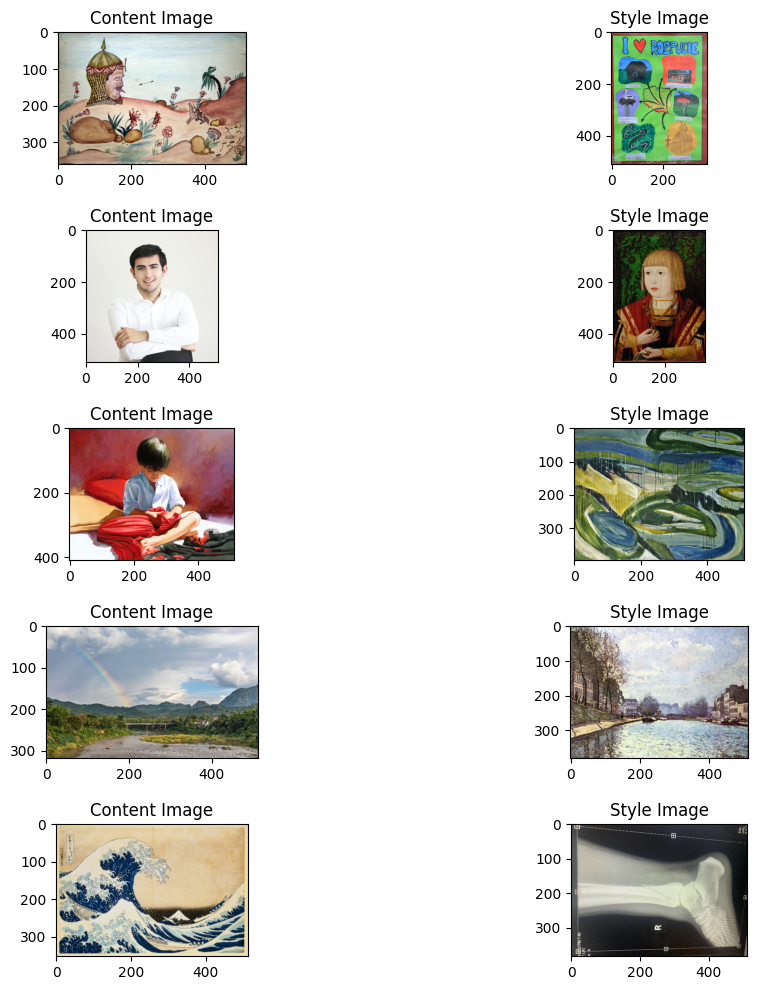

In [7]:
content_images = []  # List holding tensors of the content images
style_images = []   # List holding tensors of the style images

for content_image_url, style_image_url in zip(content_image_urls, style_image_urls):
  content_image = load_image(content_image_url)
  style_image = load_image(style_image_url)

  content_images.append(content_image)
  style_images.append(style_image)

num_images = len(content_images)
for i in range(num_images):
  plt.subplot(num_images, 2, i * 2 + 1)
  display_img(content_images[i], 'Content Image')

  plt.subplot(num_images, 2, (i+1) * 2)
  display_img(style_images[i], 'Style Image')

  plt.subplots_adjust(hspace=0.5)  # Adjust this value as needed

# Build the Model

Now that we have our content and style inputs, let's go ahead and build the 3 CNNs of interest: VGG-19, VGG-16, and ResNet50.

In [8]:
def vgg_19_layers(layer_names):
  """ Creates a VGG-19 model that returns a list of intermediate output values."""
  # Load in VGG19 network.
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False

  # Intermediary layers that we'll use for stylization
  outputs = [vgg.get_layer(name).output for name in layer_names]

  # Create a model with the VGG and our intermediary layers
  model = tf.keras.Model([vgg.input], outputs)
  return model

In [9]:
def vgg_16_layers(layer_names):
  """ Creates a VGG-16 model that returns a list of intermediate output values."""
  # Load in VGG16 network.
  vgg = tf.keras.applications.VGG16(include_top=False, weights='imagenet')
  vgg.trainable = False

  # Intermediary layers that we'll use for stylization
  outputs = [vgg.get_layer(name).output for name in layer_names]

  # Create a model with the VGG and our intermediary layers
  model = tf.keras.Model([vgg.input], outputs)
  return model

In [10]:
def resnet_50_layers(layer_names):
  """ Creates a ResNet50 model that returns a list of intermediate output values."""
  # Load in ResNet50 network
  resnet = tf.keras.applications.resnet50.ResNet50(include_top=False, weights='imagenet')
  resnet.trainable = False

  # Intermediary layers that we'll use for stylization
  outputs = [resnet.get_layer(name).output for name in layer_names]

  # Create a model with the resnet and our intermediary layers
  model = tf.keras.Model([resnet.input], outputs)
  return model

# Extract the Content

The CNNs are used to extract a hierarchy of features from an image. This is acheived by defining the intermediary layers that we generate our feature maps for this hierarchy.

Now we will define which layers in particular will represent our style and content.

In [11]:
vgg_content_layers = ['block5_conv2']

vgg_style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1',
                'block4_conv1',
                'block5_conv1']

vgg_num_content_layers = len(vgg_content_layers)
vgg_num_style_layers = len(vgg_style_layers)

In [12]:
resnet_content_layers = ['conv2_block1_2_conv']

resnet_style_layers = ['conv1_conv',
                       'conv2_block1_1_conv',
                       'conv2_block2_1_conv',
                       'conv2_block3_1_conv']

resnet_num_content_layers = len(resnet_content_layers)
resnet_num_style_layers = len(resnet_style_layers)

# Extract the Style

## Gram Matrix

The paper defines the style features in layer $l$ of the CNN as the pairwise relationships between all $N_l$ filter responses with each other. Altogether, we can store each of these pairwise relationships (or as the paper calls it feature correlations) into what we call the Gram matrix $G^l \in \mathbb{R}^{N_l \times N_l}$. In the Gram Matrix, each element $G_{cd}^l$ is the inner product of the feature maps $c$ and $d$ in layer $l$.

In [13]:
def gram_matrix(input):
  """
      Input is a 4D tensor with dimensions [batch_size, height, width, num_channels]
          batch_size: number of images in the input tensor
          height: spatial dimensions of each image
          width: spatial dimensions of each image
          num_channels: number of output channels in the layer that produced the input tensor
  """
  result = tf.linalg.einsum('bijc,bijd->bcd', input, input)
  input_shape = tf.shape(input)

  # Total locations in input
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)

  return result

# Extracting Style and Content Tensors

Now we define a model that will extract the style and content features of an image based on either pretrained VGG-19, VGG-16, or ResNet50 model.

In [14]:
class StyleContentModel(tf.keras.models.Model):
  """
      Extract style and content features from an input image using
      a pre-trained network.
  """


  def __init__(self, style_layers, content_layers, model):
    super(StyleContentModel, self).__init__()
    # Load pre-trained model and set layers for style and content extraction
    self.modelname = model

    if self.modelname == 'vgg19':
      self.model = vgg_19_layers(style_layers + content_layers)
    elif self.modelname == 'vgg16':
      self.model = vgg_16_layers(style_layers + content_layers)
    elif self.modelname == 'resnet50':
      self.model = resnet_50_layers(style_layers + content_layers)

    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.num_content_layers = len(content_layers)

    # Ensure that the pre-trained VGG19 weights are not updated during training
    self.model.trainable = False

  def call(self, inputs):
    """Expects float input in [0,1]"""
    # Preprocess input image to ensure that it is similar format to the training data of VGG
    inputs = inputs*255.0

    if self.modelname == 'vgg19':
      preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    elif self.modelname == 'vgg16':
      preprocessed_input = tf.keras.applications.vgg16.preprocess_input(inputs)
    elif self.modelname == 'resnet50':
      preprocessed_input = tf.keras.applications.resnet50.preprocess_input(inputs)

    # Extract style and content features using VGG19
    outputs = self.model(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:])

    # Compute Gram Matrix for each style feature
    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    # Create a dictionary of content features (the hierarchy)
    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

    # create a dictionary of our gram matrices, our style features
    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

  # Create overall dictionary of content and style where
  # Keys: layer names, values: respective features extracted from those layers
    return {'content': content_dict, 'style': style_dict}

# Compute Loss for Style and Content Features

In [15]:
def style_content_loss(outputs, style_targets, content_targets, num_style_layers, num_content_layers, style_weight=1e-2, content_weight=1e4):
    """
        Calculates the style and content loss using mean-squared error
        and adds them together to get total loss
    """
    # Get extracted style and content features for input image x
    style_outputs = outputs['style']
    content_outputs = outputs['content']

    # Calculate the mean-squared error for each layer between 'x' and 'a'
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2)
                           for name in style_outputs.keys()])
    # Weigh by style_weight
    style_loss *= style_weight / num_style_layers

    # Calculate mean-squared error between 'x' and 'p'
    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2)
                             for name in content_outputs.keys()])
    # Weigh by content_weight
    content_loss *= content_weight / num_content_layers

    # Want to ultimately minimize one thing: total loss
    total_loss = style_loss + content_loss
    return total_loss

# Minimize Loss via Gradient Descent


We've computed loss for content and style, but we must perform **back-propagation** so that we eventually calculate the gradient of the total loss with respect to our input image.

This function below is used to ensure the pixels of the image stay between 0 and 1 while training.

In [16]:
def clip_0_1(image):
  """
      Keep the pixels of image between 0 and 1. Since this is a float image,
      pixel values can be a decimal between 0 and 1, just not integers.
  """
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

Here is a step in the training process.

In [17]:
class TrainStep(tf.Module):
  def __init__(self, optimizer):
    self.optimizer = optimizer

  @tf.function
  def __call__(self, image, extractor, style_targets, content_targets, num_style_layers, num_content_layers):
    with tf.GradientTape() as tape:
      # Corresponds to the activations of a particular layer
      # For calculating the style and content losses during training
      outputs = extractor(image)
      # Call on previously defined function to compute loss for style/content
      loss = style_content_loss(outputs, style_targets, content_targets, num_style_layers, num_content_layers)

    # Find gradient of style/content loss
    grad = tape.gradient(loss, image)
    # Apply gradient to image using Adam
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

# Image Style Transfer Time

Now we will train the model to perform image style transfer. We choose to do 5 epochs of training with 20 steps per epoch because we noticed after about 100 epochs, the model tends to converge.

In [18]:
# Hyperparameters
epochs = 5
steps_per_epoch = 20

style_weight = 1e-2
content_weight = 1e4

This acts as our training script to test all the different CNNs on the different images.

-------------------vgg19-------------------
----------Image Pair 1---------
....................

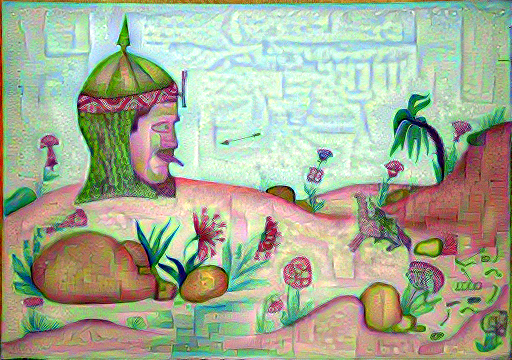

Train step: 20
....................

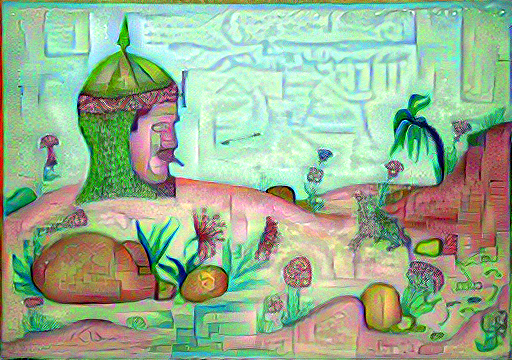

Train step: 40
....................

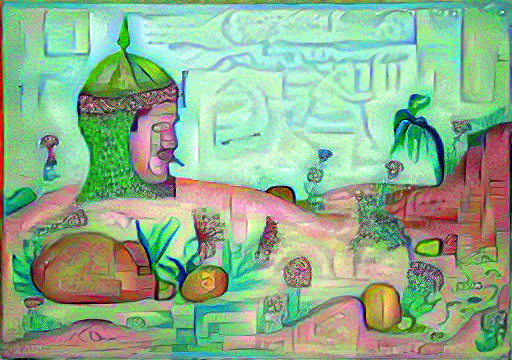

Train step: 60
....................

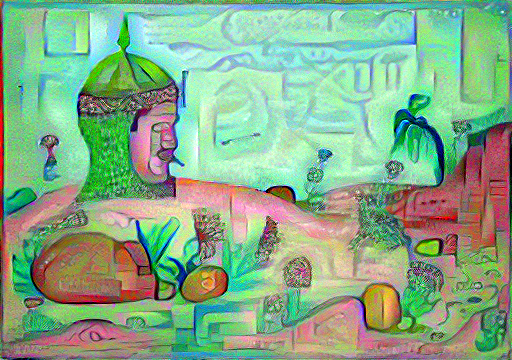

Train step: 80
....................

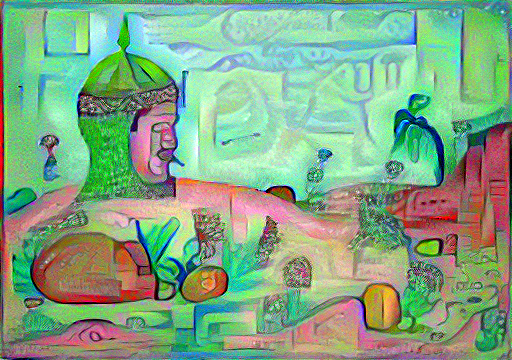

Train step: 100
----------Image Pair 2---------
....................

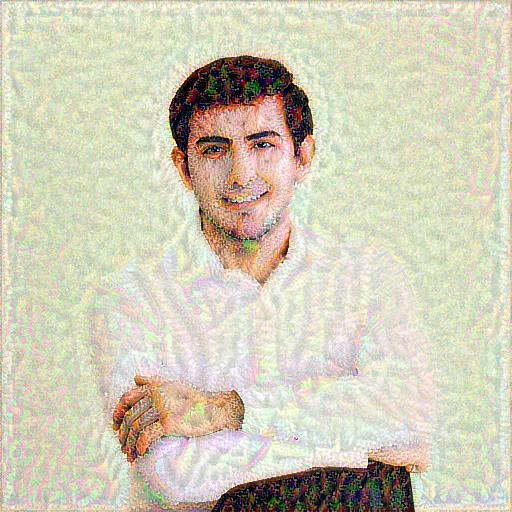

Train step: 20
....................

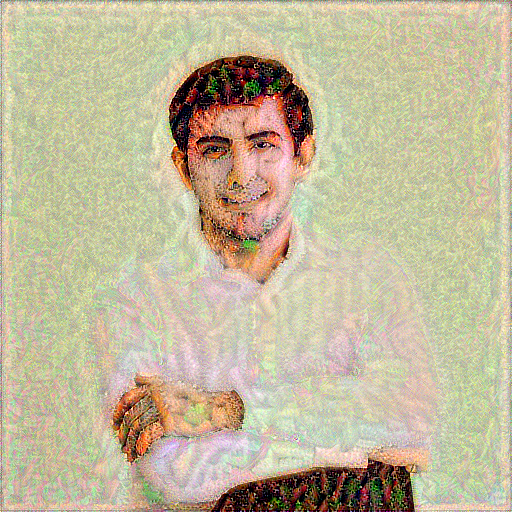

Train step: 40
....................

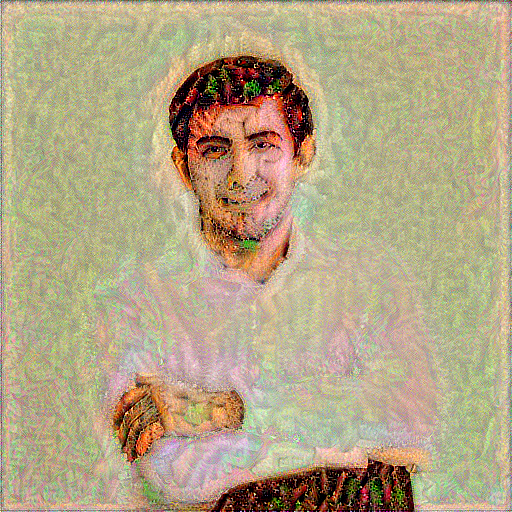

Train step: 60
....................

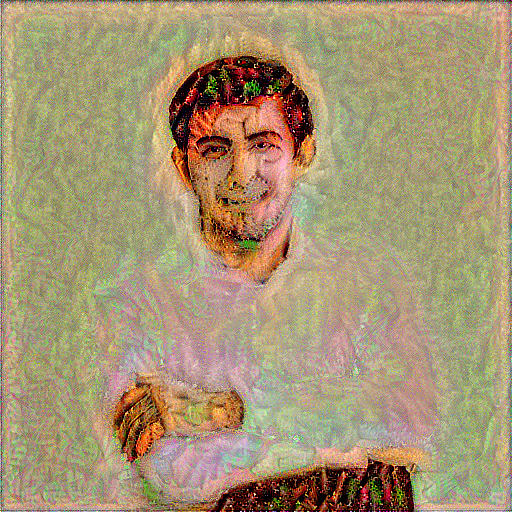

Train step: 80
....................

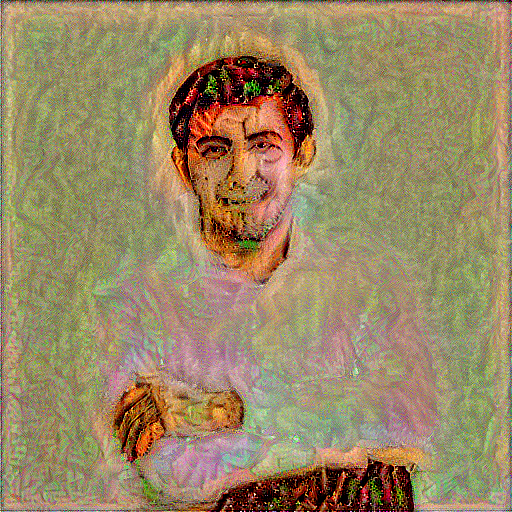

Train step: 100
----------Image Pair 3---------
....................

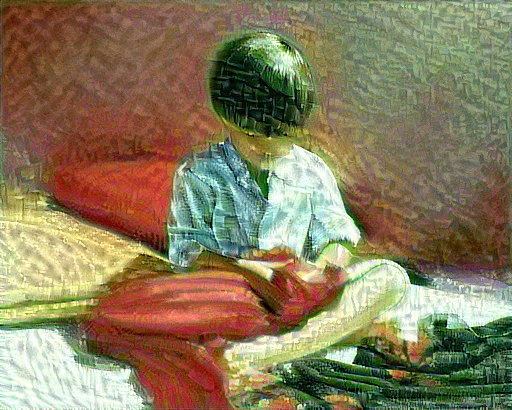

Train step: 20
....................

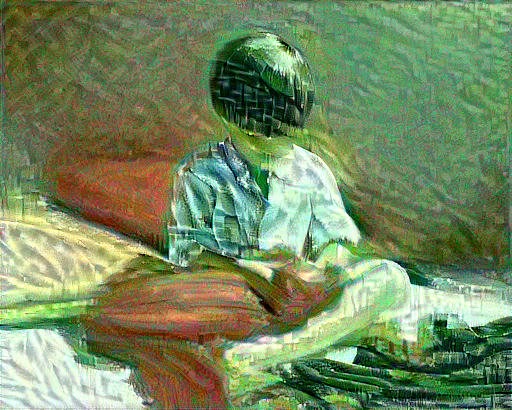

Train step: 40
....................

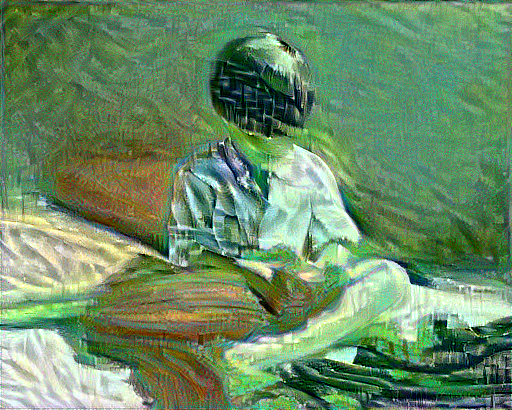

Train step: 60
....................

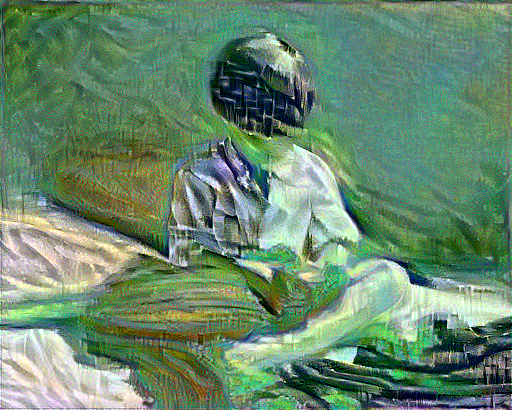

Train step: 80
....................

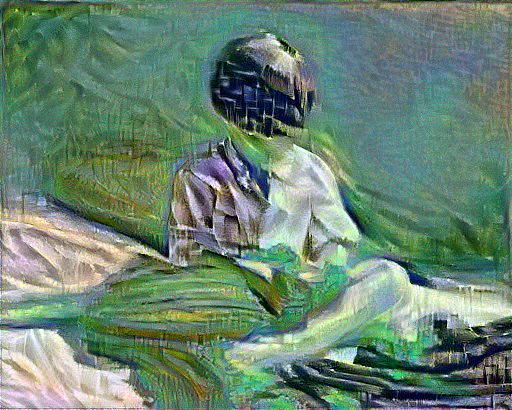

Train step: 100
----------Image Pair 4---------
....................

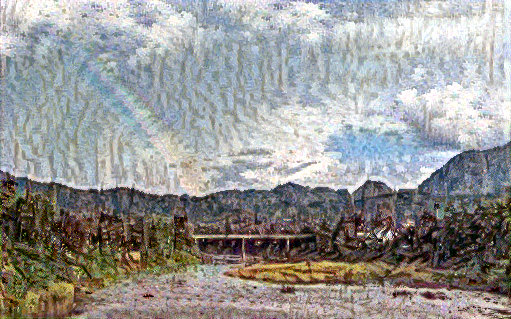

Train step: 20
....................

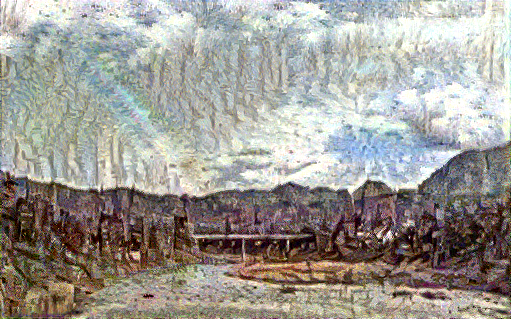

Train step: 40
....................

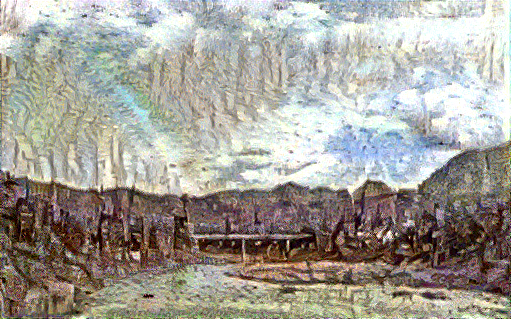

Train step: 60
....................

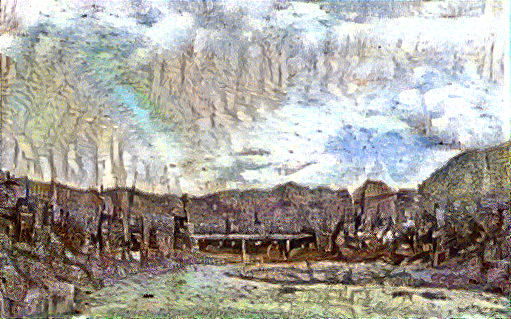

Train step: 80
....................

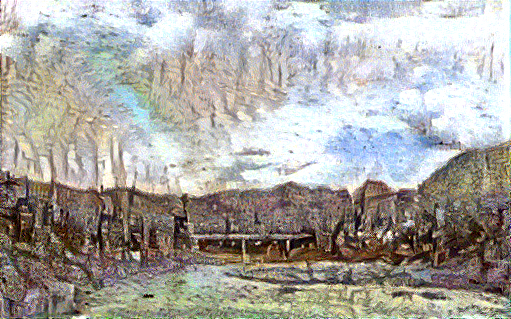

Train step: 100
----------Image Pair 5---------
....................

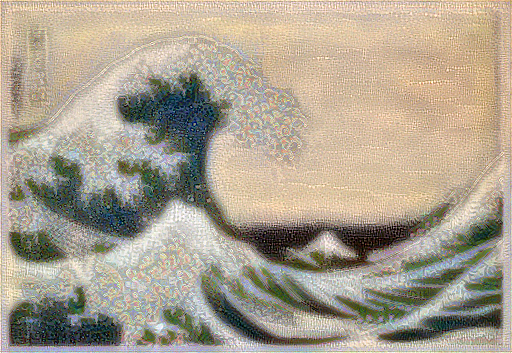

Train step: 20
....................

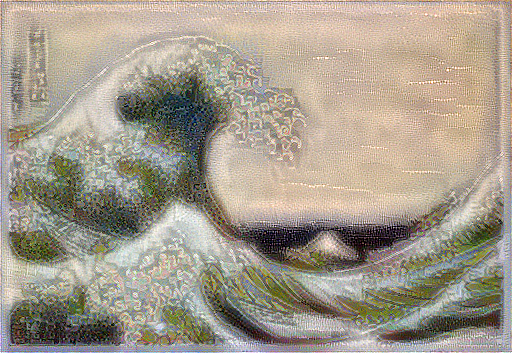

Train step: 40
....................

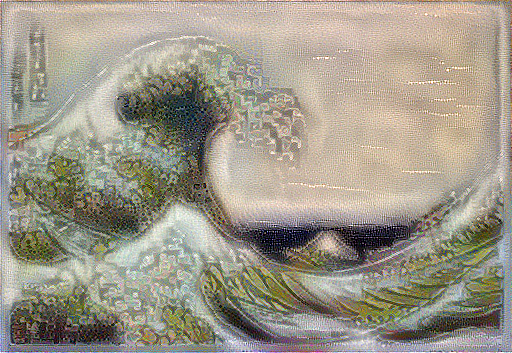

Train step: 60
....................

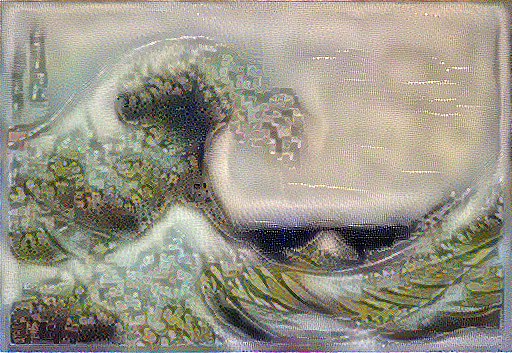

Train step: 80
....................

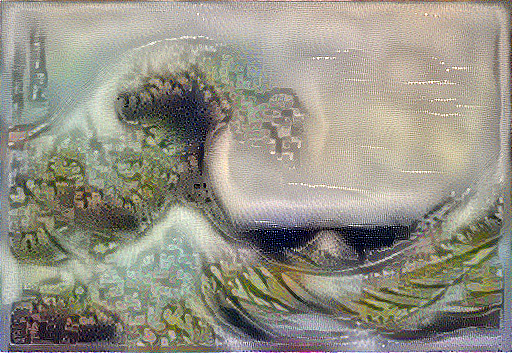

Train step: 100
-------------------vgg16-------------------
----------Image Pair 1---------
....................

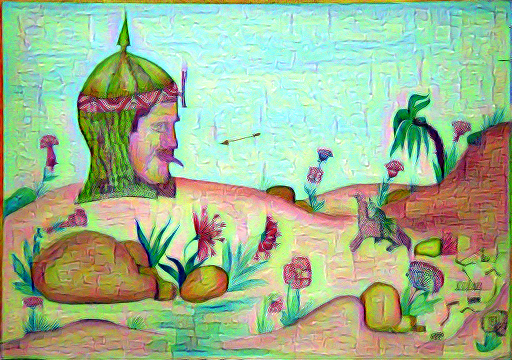

Train step: 20
....................

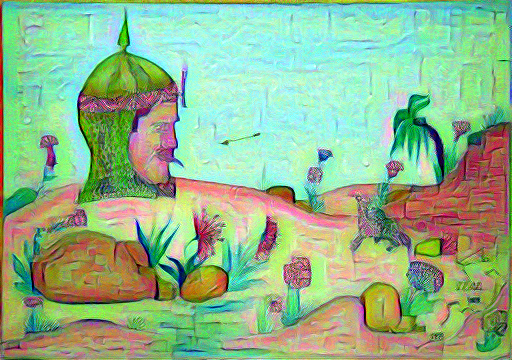

Train step: 40
....................

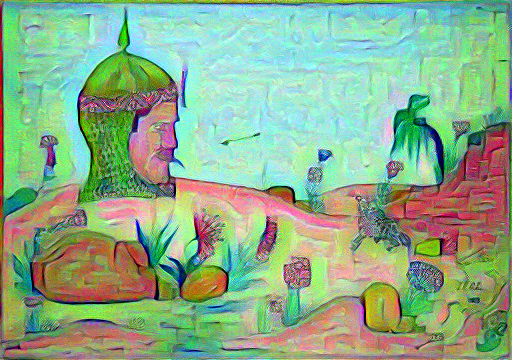

Train step: 60
....................

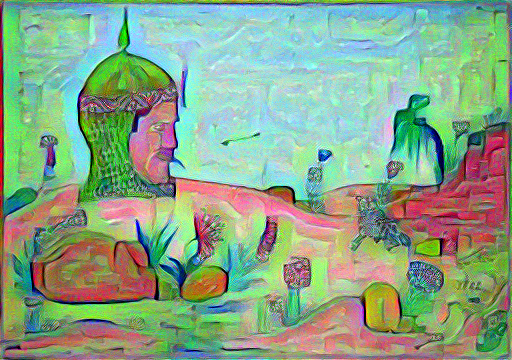

Train step: 80
....................

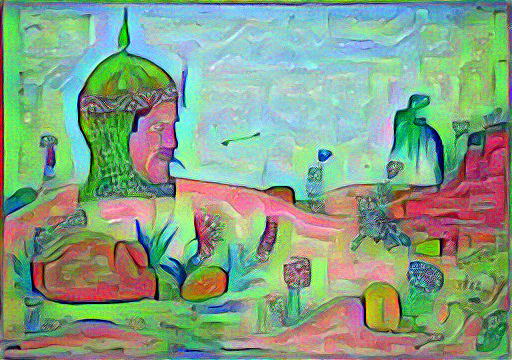

Train step: 100
----------Image Pair 2---------
....................

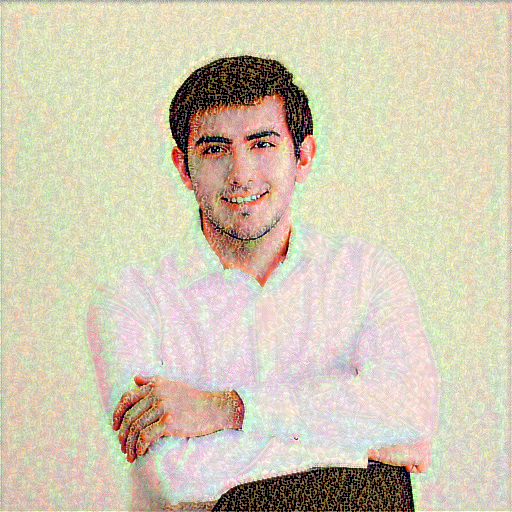

Train step: 20
....................

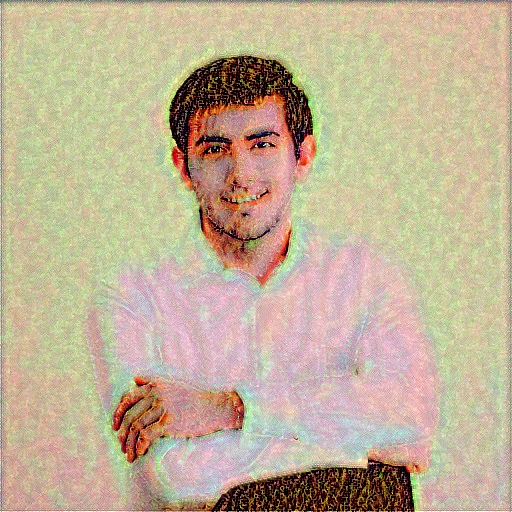

Train step: 40
....................

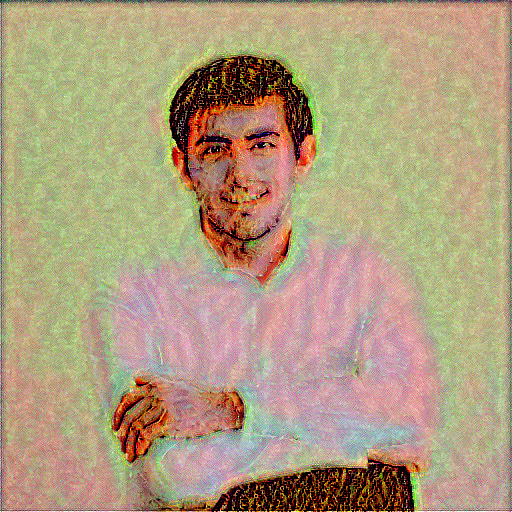

Train step: 60
....................

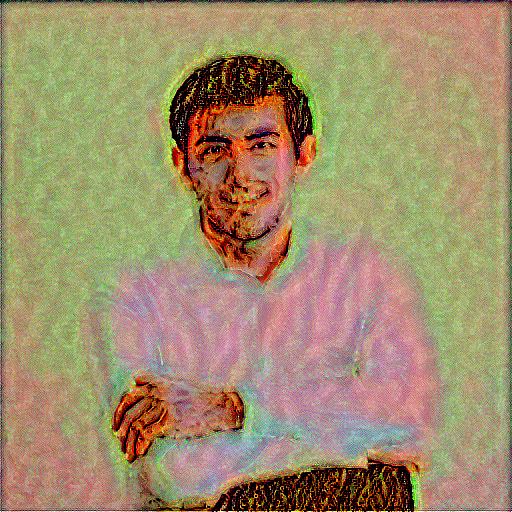

Train step: 80
....................

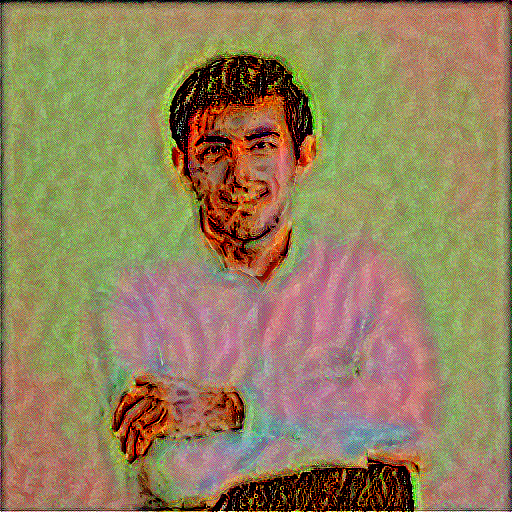

Train step: 100
----------Image Pair 3---------
....................

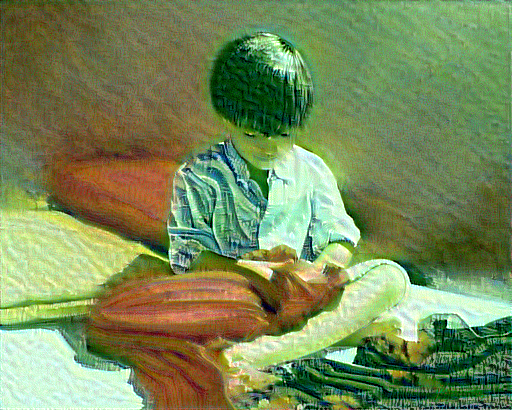

Train step: 20
....................

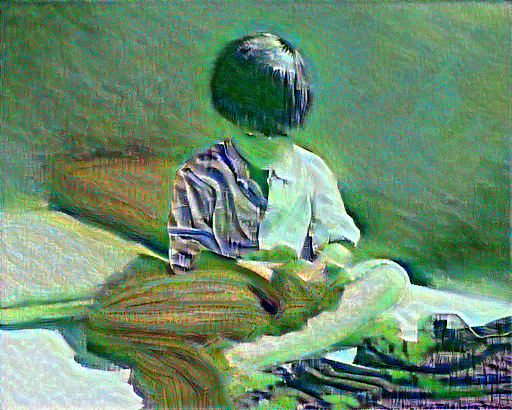

Train step: 40
....................

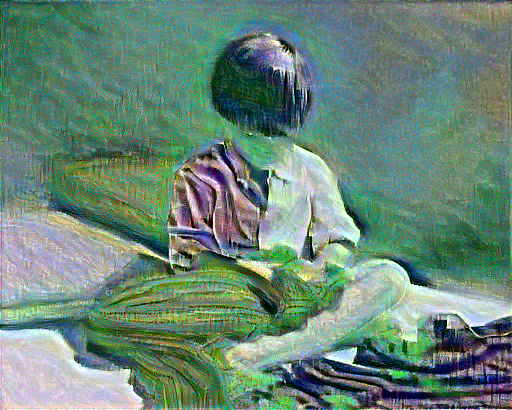

Train step: 60
....................

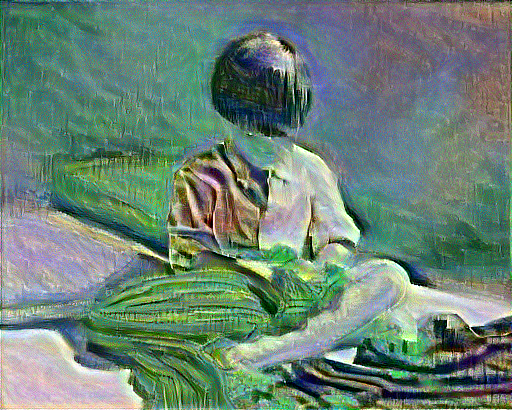

Train step: 80
....................

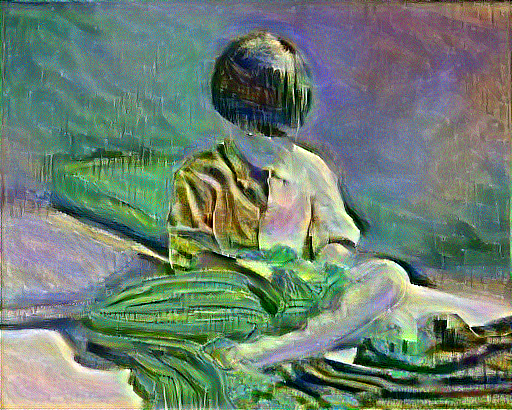

Train step: 100
----------Image Pair 4---------
....................

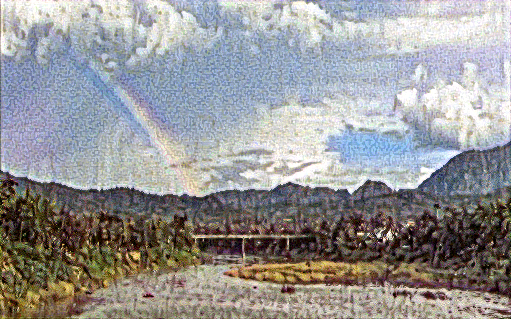

Train step: 20
....................

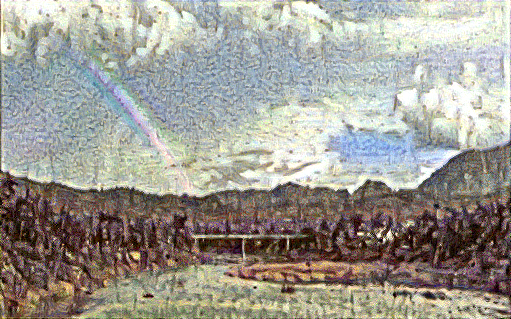

Train step: 40
....................

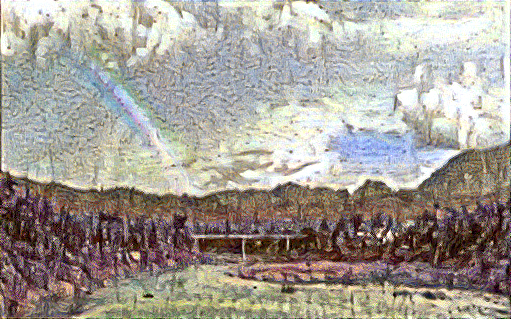

Train step: 60
....................

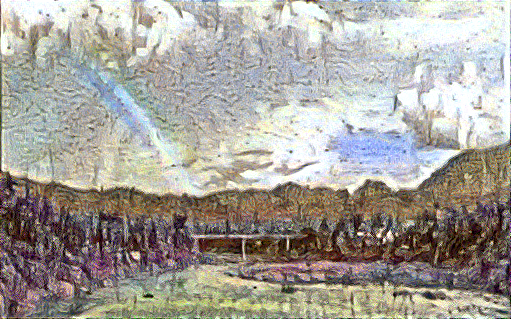

Train step: 80
....................

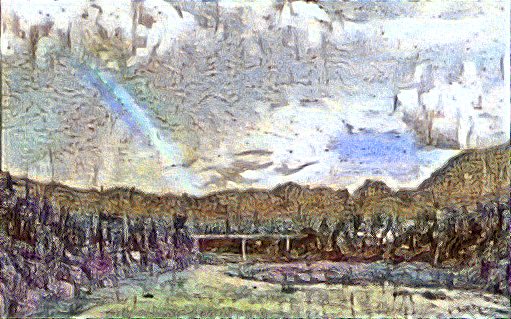

Train step: 100
----------Image Pair 5---------
....................

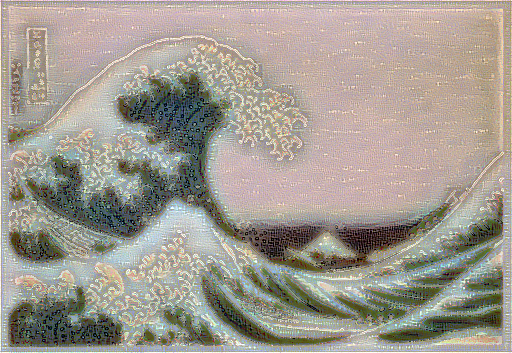

Train step: 20
....................

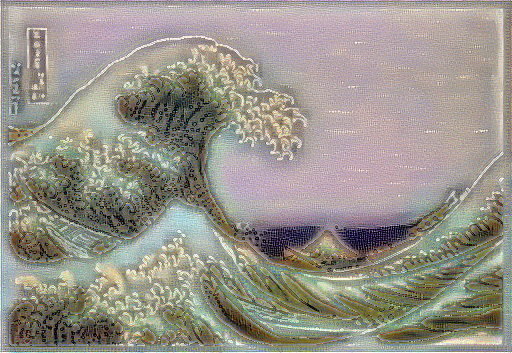

Train step: 40
....................

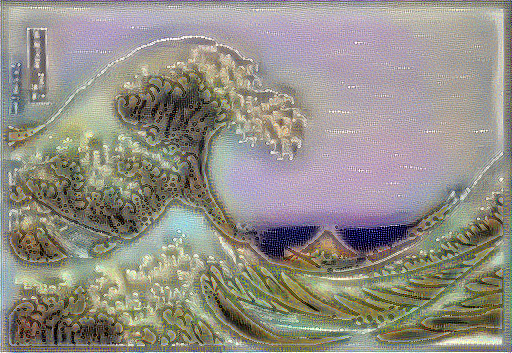

Train step: 60
....................

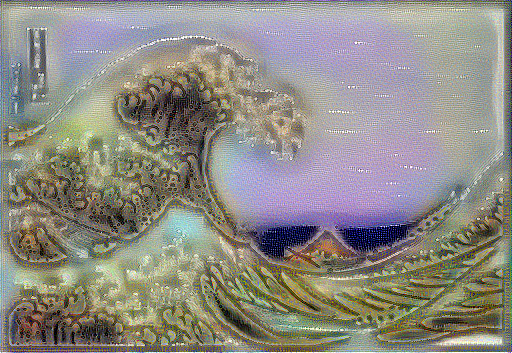

Train step: 80
....................

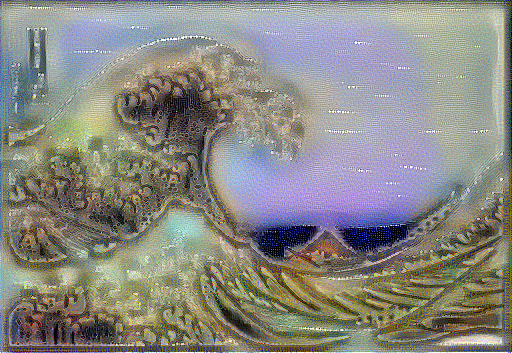

Train step: 100
-------------------resnet50-------------------
----------Image Pair 1---------
....................

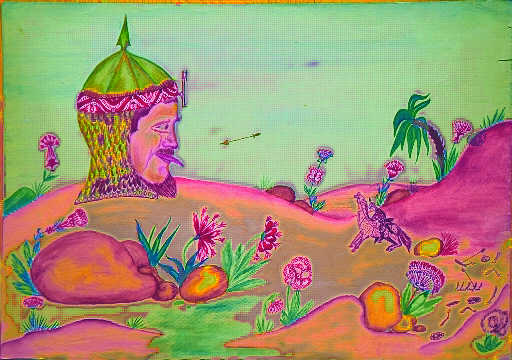

Train step: 20
....................

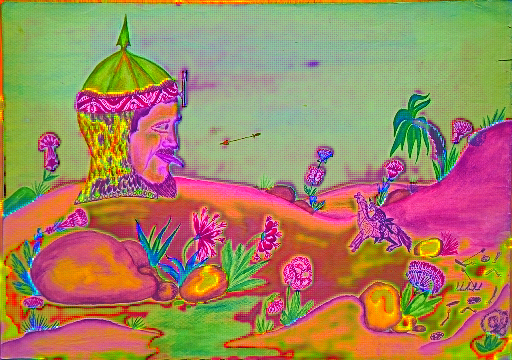

Train step: 40
....................

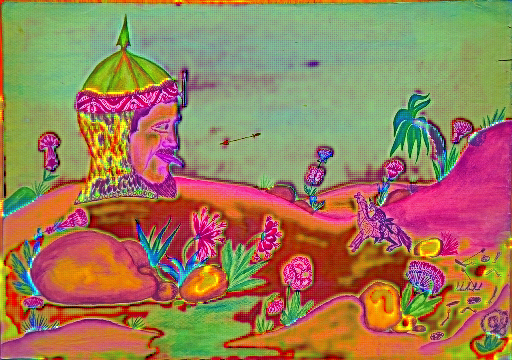

Train step: 60
....................

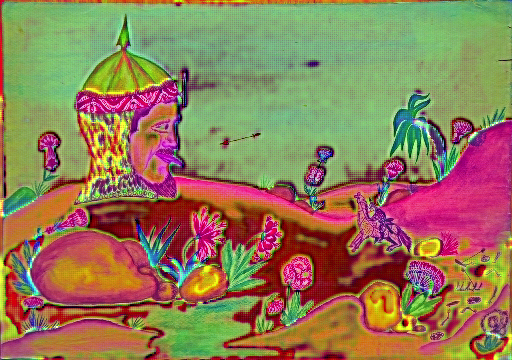

Train step: 80
....................

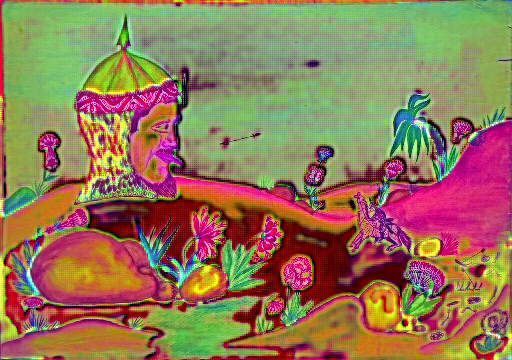

Train step: 100
----------Image Pair 2---------
....................

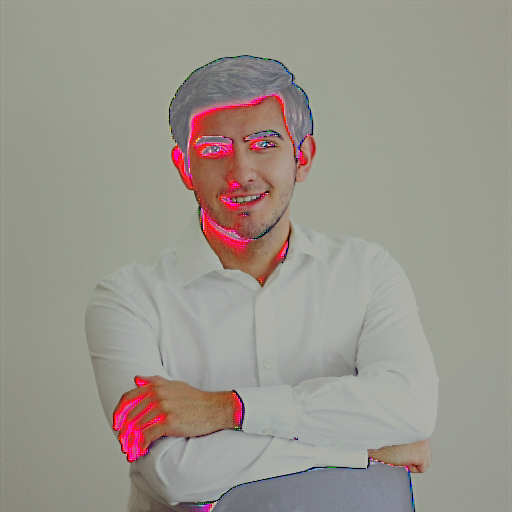

Train step: 20
....................

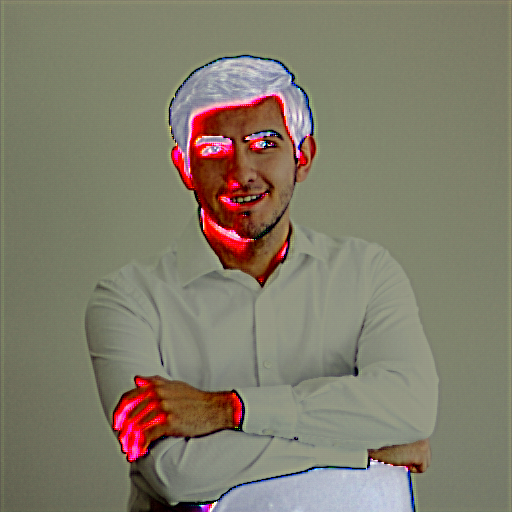

Train step: 40
....................

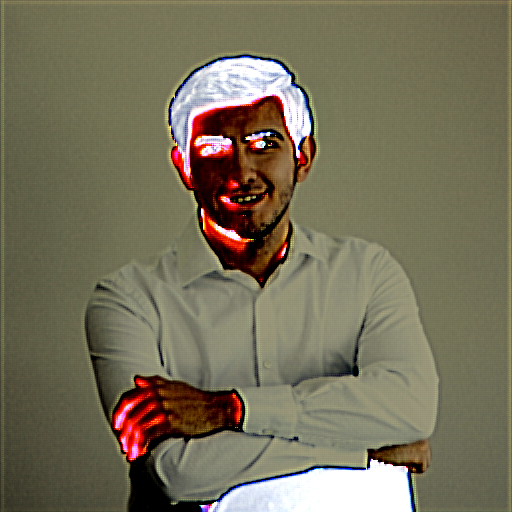

Train step: 60
....................

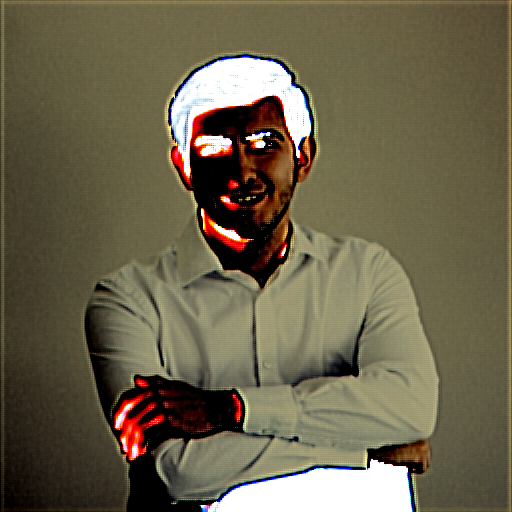

Train step: 80
....................

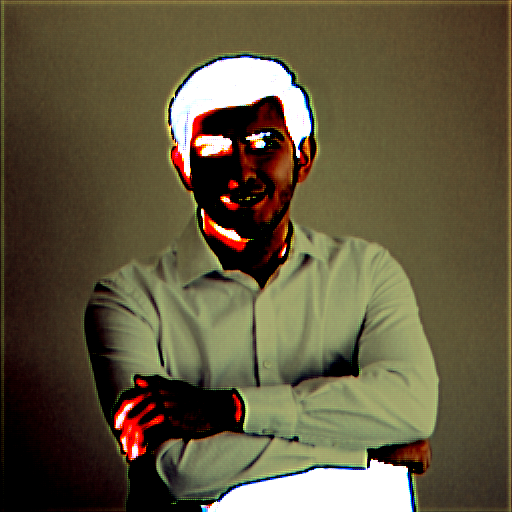

Train step: 100
----------Image Pair 3---------
....................

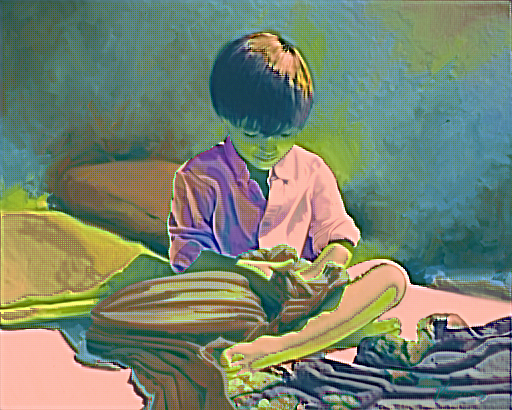

Train step: 20
....................

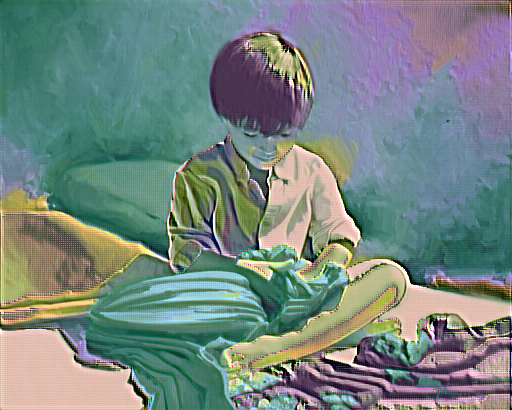

Train step: 40
....................

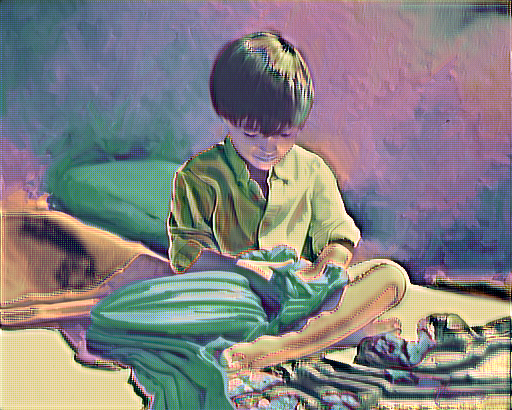

Train step: 60
....................

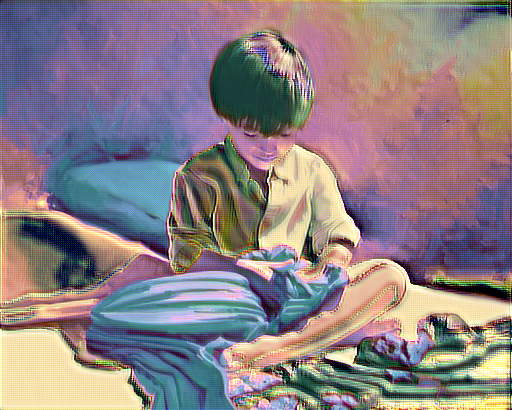

Train step: 80
....................

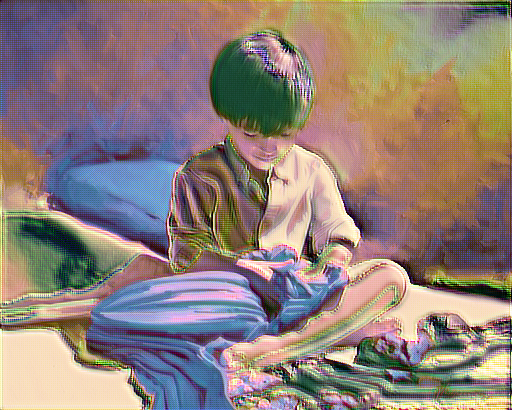

Train step: 100
----------Image Pair 4---------
....................

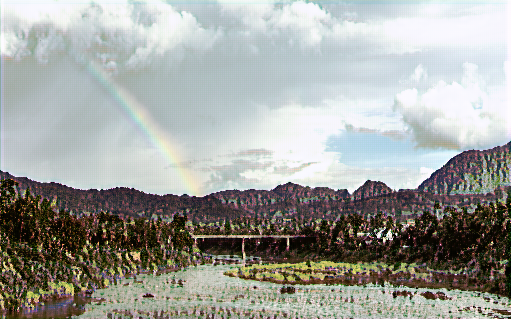

Train step: 20
....................

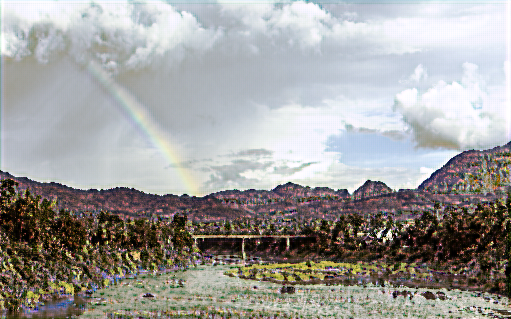

Train step: 40
....................

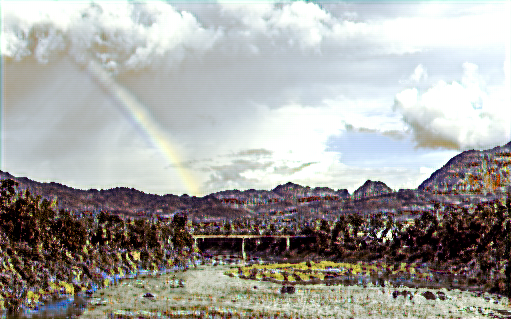

Train step: 60
....................

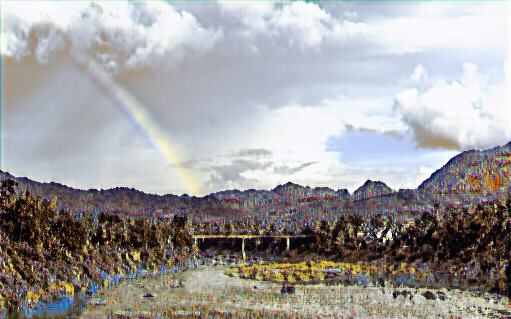

Train step: 80
....................

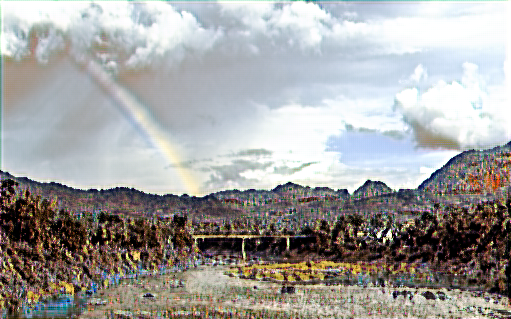

Train step: 100
----------Image Pair 5---------
....................

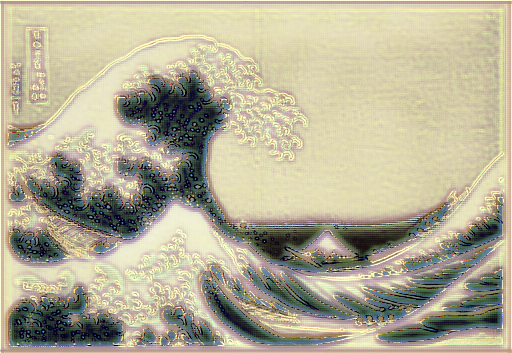

Train step: 20
....................

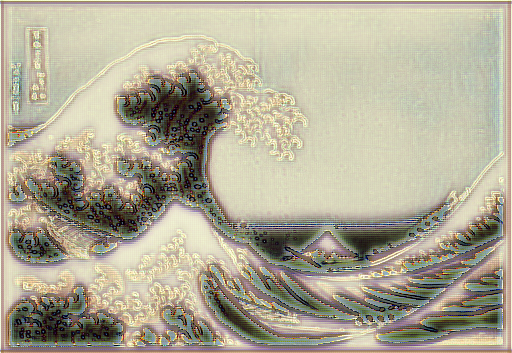

Train step: 40
....................

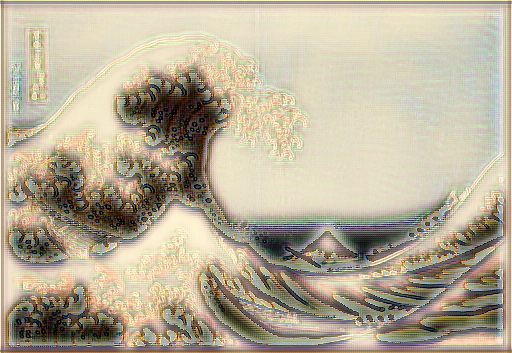

Train step: 60
....................

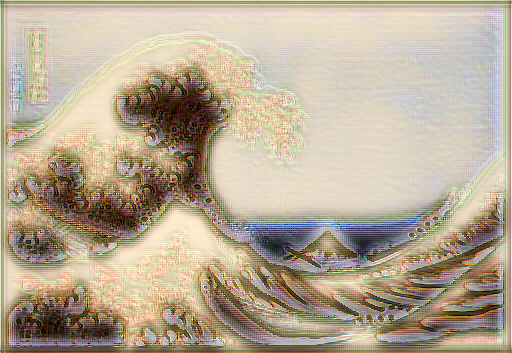

Train step: 80
....................

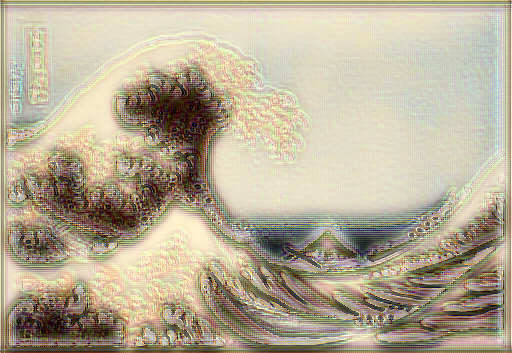

Train step: 100


In [20]:
all_extractors = [
  [StyleContentModel(vgg_style_layers, vgg_content_layers, model='vgg19') for _ in range(num_images)],
  [StyleContentModel(vgg_style_layers, vgg_content_layers, model='vgg16') for _ in range(num_images)],
  [StyleContentModel(resnet_style_layers, resnet_content_layers, model='resnet50') for _ in range(num_images)]
]

all_optimizers = [
  [tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1) for _ in range(num_images)],
  [tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1) for _ in range(num_images)],
  [tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1) for _ in range(num_images)]
]

image = tf.Variable(content_images[0])

for j in range(len(all_extractors)):
  extractors = all_extractors[j]
  optimizers = all_optimizers[j]

  model_name = extractors[0].modelname
  print(f"-------------------{model_name}-------------------")

  image_num = 1
  num_style_layers = extractors[0].num_style_layers
  num_content_layers = extractors[0].num_content_layers

  for i in range(num_images):
    content_image = content_images[i]
    style_image = style_images[i]
    extractor = extractors[i]
    opt = optimizers[i]

    # image.assign(content_image)
    image = tf.Variable(content_image)

    # Style features from original style image, 'a'
    style_targets = extractor(style_image)['style']

    # Content features from original content image, 'p'
    content_targets = extractor(content_image)['content']

    train = TrainStep(opt)

    print(f"----------Image Pair {image_num}---------")
    step = 0
    for n in range(epochs):
      for m in range(steps_per_epoch):
        step += 1
        train(image, extractor, style_targets, content_targets, num_style_layers, num_content_layers)
        print(".", end='', flush=False)
      display.display(tensor_to_image(image))
      print("Train step: {}".format(step))

    image_num += 1